# Trabajo Práctico N°2 - Filtrado lineal óptimo
## Autores
## Bertachini, Germán 
## Torino, Joaquín 


#### Para este trabajo práctico se deberá modelar la respuesta al impulso h(n) de un sistema parlante-habitación-micrófono con identificación de sistemas, asumiendo régimen estacionario.

El estudio sobre que señales era conveniente utilizar y el modelo de parlante-habitación-micrófono utilizado se encuentra en el notebook "signals.ipynb". En este documento nos limitaremos a analizar las señales elegidas.

### Liberías utilizadas

In [346]:
%pip install -r requirements.txt

Note: you may need to restart the kernel to use updated packages.


In [347]:
import numpy as np
from scipy import linalg
from scipy import signal as sp
from IPython.display import Image
from scipy.io.wavfile import read
import struct
import matplotlib.pyplot as plt
import IPython.display as ipd
import sounddevice as sd
import soundfile as sf
import importlib, auxiliary as aux
importlib.reload(aux)    # MUY importante

<module 'auxiliary' from 'c:\\Users\\jtori\\source\\repos\\PASA-TP2\\auxiliary.py'>

### Parámetros

In [348]:
# # frequency is the number of times a wave repeats a second

# fs = 48e3

num_samples = 480000
time_frame=10
# # Se utiliza una frecuencia de muestreo de 48KHz al ser la nativa de las placas de audio.
# sampling_rate = 48000.0
# amplitude = 32000 #Usamos la amplitud maxima disponible

# nframes=48000
# comptype="NONE"
# #Manipulamos los archivos en formato wav pero al no usar ningun tipo de compresion trabajamos con los datos originales
# compname="not compressed"
# nchannels=1
# sampwidth=2
# #configuracion de audio
# sd.default.samplerate = int(sampling_rate)
# sd.default.channels = 2


## 1. Señales de trabajo

### 1.1 Señal de voz - $x_1(n)$

### Señal original

In [349]:
x_speech, fs = sf.read('../PASA-TP2/tracks/x_speech.wav', dtype='float32')
print(f'Sample rate: {fs}, Audio length: {x_speech.shape[0]/fs} seconds')
ipd.Audio(x_speech, rate=fs)

Sample rate: 48000, Audio length: 10.516729166666666 seconds


### Señal grabada

In [350]:
y_speech, fs = sf.read('../PASA-TP2/tracks/y_speech_cuarto.wav', dtype='float32')
print(f'Sample rate: {fs}, Audio length: {y_speech.shape[0]/fs} seconds')
ipd.Audio(y_speech, rate=fs)

Sample rate: 48000, Audio length: 10.516729166666666 seconds


Comparamos ambas señales en el tiempo, para comparar la señal original con la filtrada por el sistema.

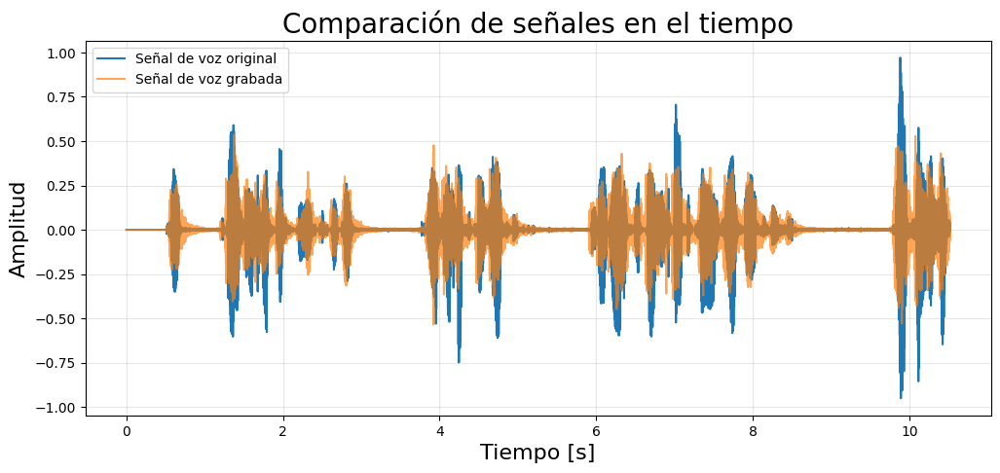

In [351]:
aux.plot_two_signals(x_speech, y_speech,fs, label1='Señal de voz original', label2='Señal de voz grabada', title='Comparación de señales en el tiempo')

#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

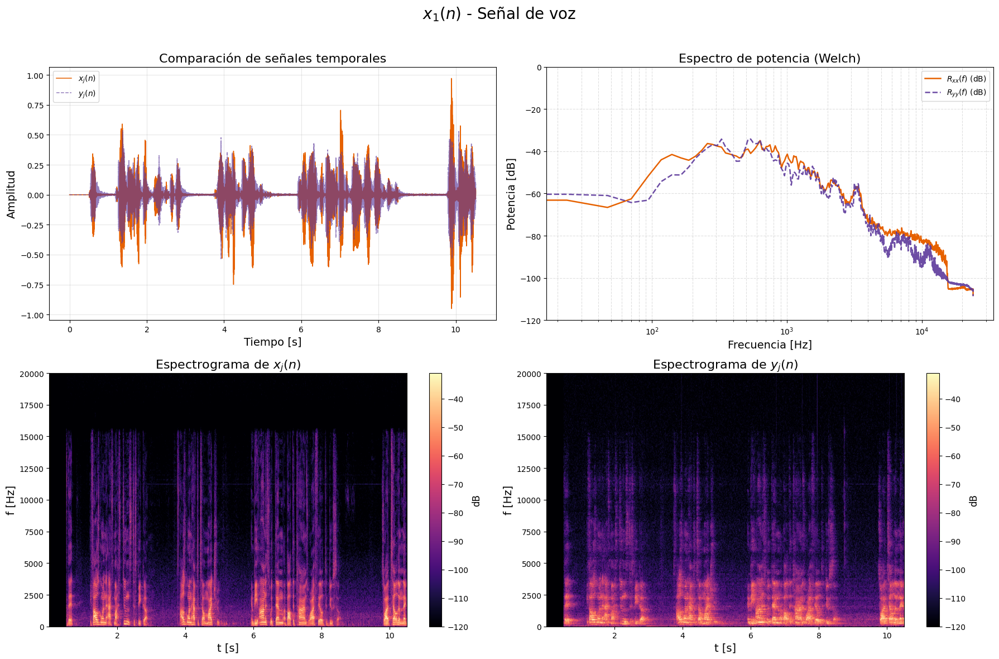

In [352]:
aux.get_graphs(x_speech, fs,y_speech, fs,'$x_1(n)$ - Señal de voz')

Al analizar el discurso antes y después de pasar por el sistema, se observa que la señal sufre modificaciones tanto en su amplitud como en su distribución espectral. La comparación de las representaciones temporales muestra que, aunque la forma global del discurso se conserva, aparecen diferencias en la dinámica y en la energía de ciertas secciones, lo que indica una atenuación selectiva introducida por el sistema. El espectro de potencia (Welch) refuerza esta idea: se aprecia una pérdida notable de energía en ciertas bandas de frecuencia, lo cual se traduce en un filtrado que afecta el contenido armónico y la claridad de la señal.

En los espectrogramas, la señal filtrada exhibe una reducción en la intensidad de las componentes de alta frecuencia y un mayor predominio de las bajas y medias, lo que sugiere que el sistema actúa como un filtro pasabajos o con características de suavizado. Esto tiene un efecto audible esperado: disminuye la inteligibilidad de algunos fonemas y reduce la riqueza espectral del discurso. En conclusión, el sistema modifica el discurso atenuando selectivamente ciertas bandas, lo que produce un resultado más “apagado” y con menos detalle en comparación con la señal original.

### 1.2 Señal de música - $x_2(n)$

### 9° Sinfonía de Beethoven
### Señal original

In [353]:
x_music_1, fs = sf.read('../PASA-TP2/tracks/x_b9s.wav', dtype='float32')
print(f'Sample rate: {fs}, Audio length: {x_music_1.shape[0]/fs} seconds')
ipd.Audio(x_music_1, rate=fs)

Sample rate: 48000, Audio length: 10.5271875 seconds


### Señal grabada

In [354]:
fs, y_music_1 = read('../PASA-TP2/tracks/y_b9s_cuarto.wav')
print(f'Sample rate: {fs}, Audio length: {y_music_1.shape[0]/fs} seconds')
ipd.Audio(y_music_1, rate=fs)

Sample rate: 48000, Audio length: 10.5271875 seconds


Comparamos ambas señales en el tiempo, para comparar la señal original con la filtrada por el sistema.

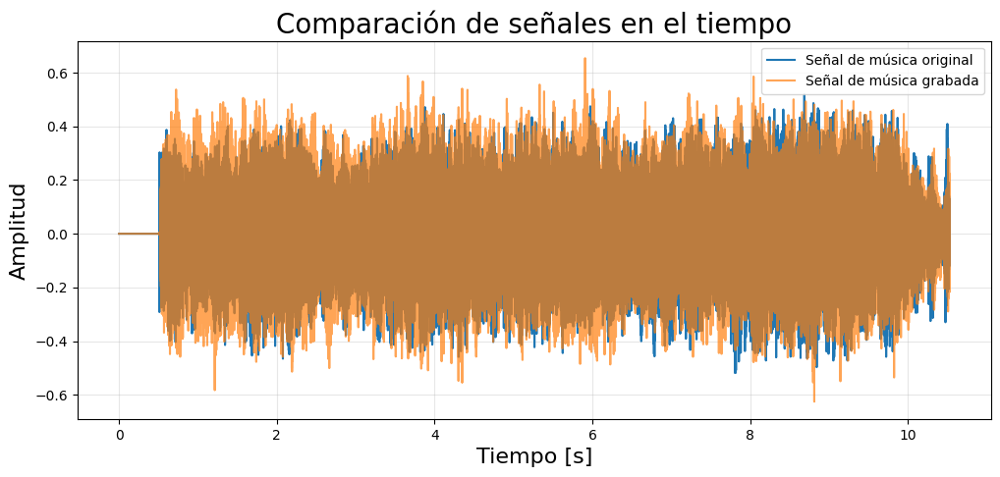

In [355]:
aux.plot_two_signals(x_music_1, y_music_1,fs, label1='Señal de música original', label2='Señal de música grabada', title='Comparación de señales en el tiempo')

#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

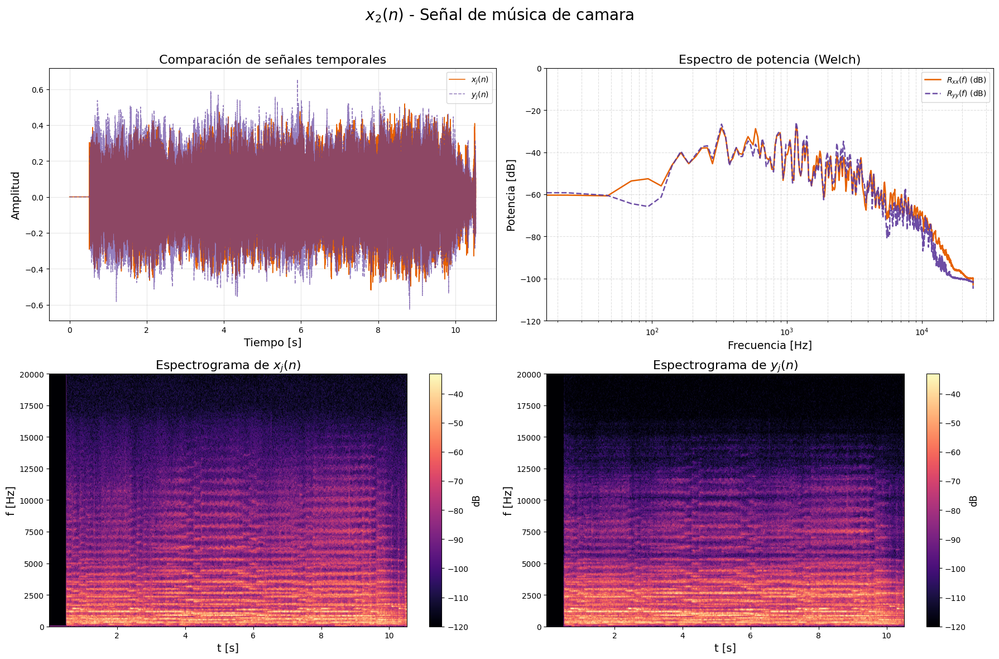

In [356]:
aux.get_graphs(x_music_1, fs,y_music_1, fs,'$x_2(n)$ - Señal de música de camara')

Ahora analizamos la otra señal de música propuesta para ver si hay mucha diferencia en el espectro.

### Waltz Op.54-1
## Señal original

In [357]:
x_music_2, fs = sf.read('../PASA-TP2/tracks/x_waltz.wav', dtype='float32')
print(f'Sample rate: {fs}, Audio length: {x_music_2.shape[0]/fs} seconds')
ipd.Audio(x_music_2, rate=fs)

Sample rate: 48000, Audio length: 10.521395833333333 seconds


### Señal Grabada

In [358]:
y_music_2, fs = sf.read('../PASA-TP2/tracks/y_waltz_cuarto.wav', dtype='float32')
print(f'Sample rate: {fs}, Audio length: {y_music_2.shape[0]/fs} seconds')
ipd.Audio(y_music_2, rate=fs)

Sample rate: 48000, Audio length: 10.516708333333334 seconds


Graficamos ambas señales en el tiempo para ver la diferencia entre la señal original y la filtrada.

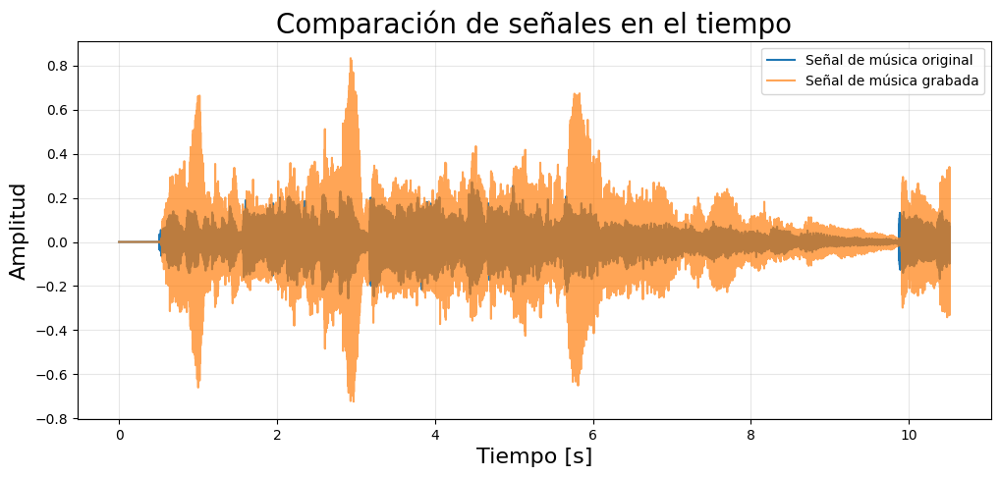

In [359]:
aux.plot_two_signals(x_music_2, y_music_2,fs, label1='Señal de música original', label2='Señal de música grabada', title='Comparación de señales en el tiempo')

#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

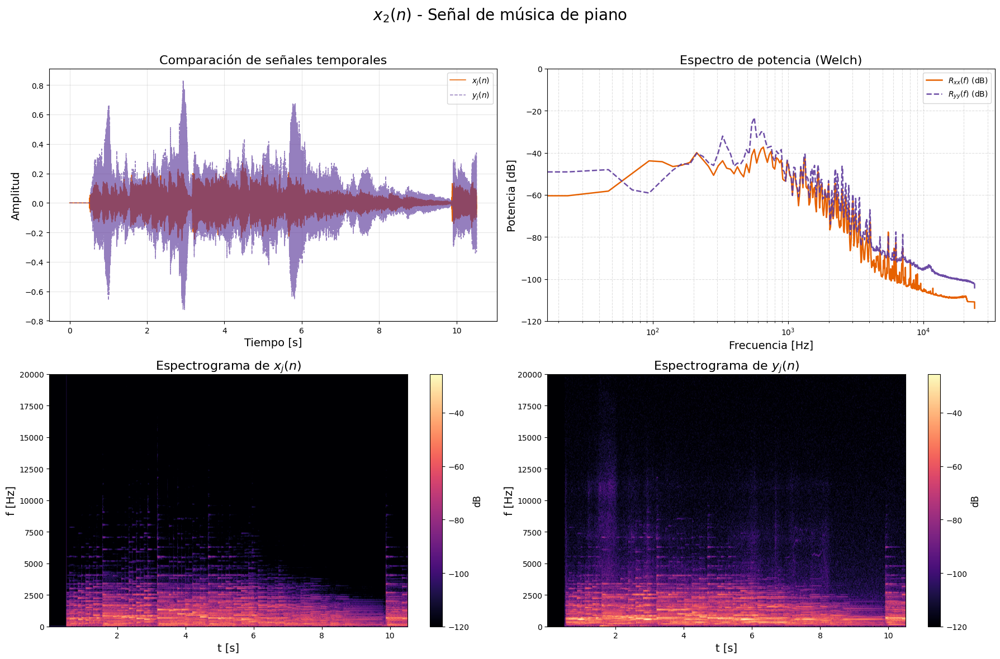

In [360]:
aux.get_graphs(x_music_2, fs,y_music_2, fs,'$x_2(n)$ - Señal de música de piano')

Conclusiones

**En el caso del piano se nota que la señal cambia bastante después de pasar por el sistema. La grabación perdió fuerza en las frecuencias medias y agudas, lo que hace que suene con menos brillo y menos presencia de armónicos. También se ve que el nivel general quedó corrido respecto del original.**

**En cambio, con la música de cámara las diferencias son más chicas. La forma de la señal y su espectro se mantienen bastante parecidos, y aunque también hay un cambio de nivel, la distribución de energía en las distintas frecuencias se conserva mejor. En general, este tipo de música parece verse menos afectada que el piano, que es más sensible por sus transitorios y armónicos altos.**

### 1.3 Señal cuadrada f=100 Hz - $x_3(n)$
### Señal original

In [361]:
x_square, fs= sf.read('../PASA-TP2/audio/prueba_square.wav', dtype='float32')
print(f'Sample rate: {fs}, Audio length: {x_square.shape[0]/fs} seconds')
ipd.Audio(x_square, rate=fs)

Sample rate: 48000, Audio length: 10.0 seconds


### Señal grabada

In [362]:
y_square, fs= sf.read('../PASA-TP2/tracks/y_square_cuarto.wav', dtype='float32')
print(f'Sample rate: {fs}, Audio length: {y_square.shape[0]/fs} seconds')
y_square = y_square[:10*fs]  
ipd.Audio(y_square, rate=fs)

Sample rate: 48000, Audio length: 10.055958333333333 seconds


Comparación temporal entre la señal original y la filtrada.

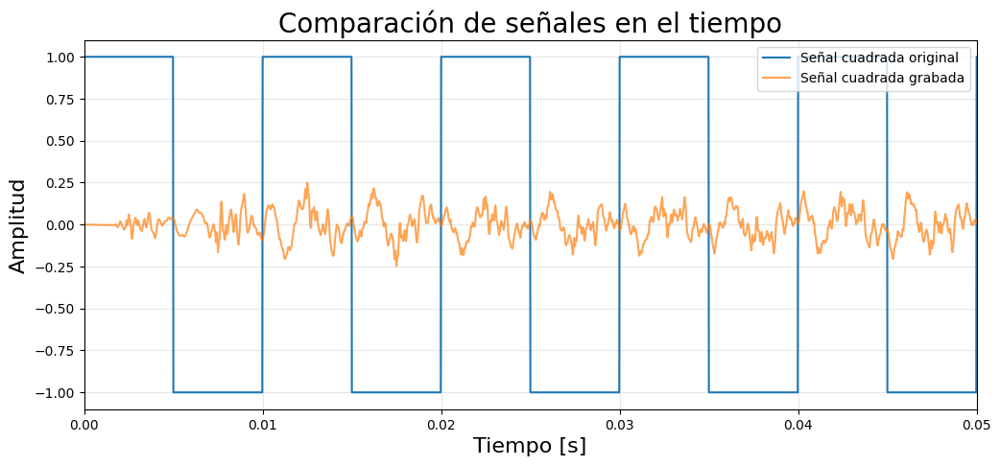

In [363]:
aux.plot_two_signals(x_square, y_square,fs, xlim=0.05, label1='Señal cuadrada original', label2='Señal cuadrada grabada', title='Comparación de señales en el tiempo')

#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

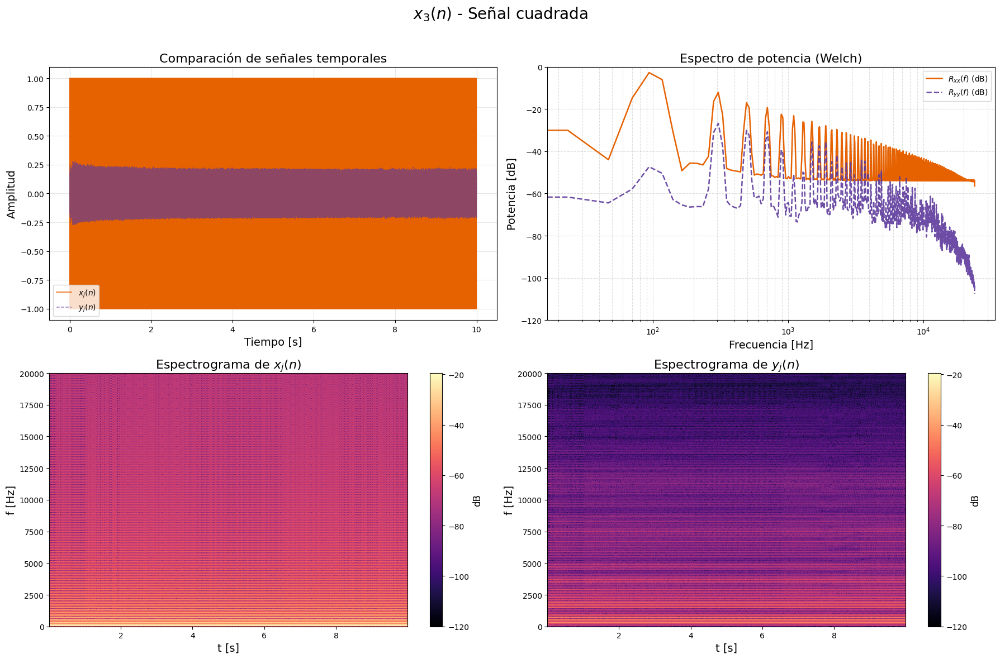

In [364]:
aux.get_graphs(x_square, fs,y_square, fs,'$x_3(n)$ - Señal cuadrada')

#### Conclusión

**A partir de la comparación entre la señal cuadrada original y la grabada se observa claramente que el sistema de reproducción y registro introduce cambios importantes. La señal original mantiene sus armónicos bien definidos y con gran energía, mientras que en la señal grabada la amplitud general es menor y los armónicos de orden alto aparecen atenuados. Esto indica que el micrófono, junto con la respuesta del parlante y la acústica del ambiente, actúan como un filtro que reduce tanto el nivel global de la señal como el contenido en altas frecuencias.**

**En los espectrogramas se confirma la misma tendencia: la señal original conserva líneas horizontales bien marcadas en todos los armónicos, mientras que en la señal grabada estos armónicos se diluyen progresivamente a medida que aumenta la frecuencia. En conjunto, los resultados muestran que el sistema no es neutro y altera significativamente la forma espectral de la señal cuadrada, lo que debe tenerse en cuenta al analizar mediciones acústicas de este tipo.**

### 1.4 Barrido lineal $x_4(n)$
#### $f_1=20Hz$ y $f_2=20KHZ$
### Señal original

In [365]:
fs, x_linear_sweep = read('../PASA-TP2/tracks/x_linsweep.wav')
x_linear_sweep = x_linear_sweep[21490:-12000]
print(f'Sample rate: {fs}, Audio length: {x_linear_sweep.shape[0]/fs} seconds')
ipd.Audio(x_linear_sweep, rate=fs)

Sample rate: 48000, Audio length: 9.8125 seconds


### Señal grabada

In [391]:
fs, y_linear_sweep = read('../PASA-TP2/tracks/y_linsweep_living.wav')
y_linear_sweep = y_linear_sweep[0:]
y_linear_sweep -= np.abs(np.mean(y_linear_sweep))
print(f'Sample rate: {fs}, Audio length: {y_linear_sweep.shape[0]/fs} seconds')
ipd.Audio(y_linear_sweep, rate=fs)

Sample rate: 48000, Audio length: 10.5491875 seconds


Comparación temportal entre la señal original y la filtrada.

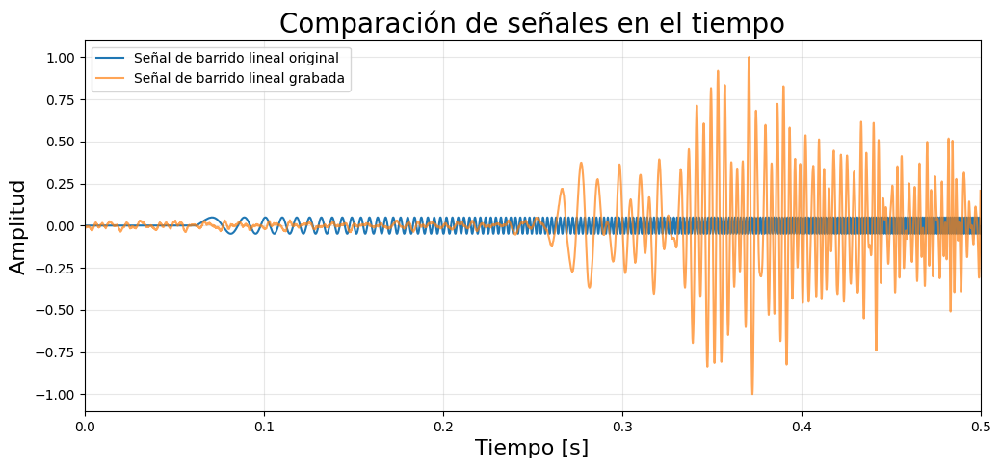

In [389]:
aux.plot_two_signals(x_linear_sweep,y_linear_sweep,fs, xlim=0.5,label1='Señal de barrido lineal original', label2='Señal de barrido lineal grabada', title='Comparación de señales en el tiempo')

#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

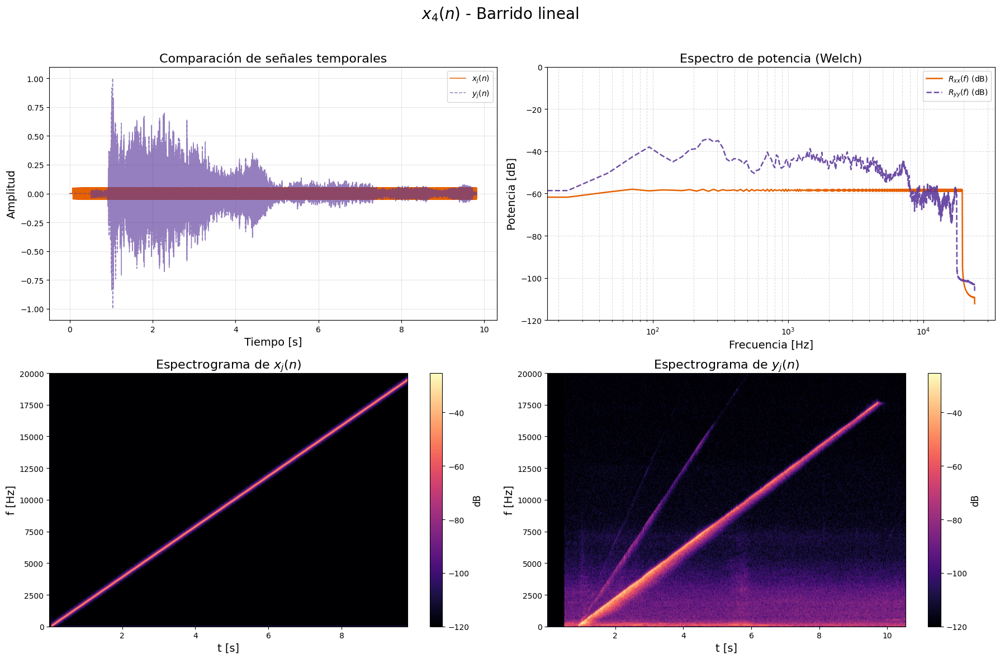

In [392]:
aux.get_graphs(x_linear_sweep, fs,y_linear_sweep, fs,'$x_4(n)$ - Barrido lineal')

#### Conclusión
**En la señal original (izquierda) se observa un barrido en frecuencia muy limpio, que inicia en los 20 Hz y progresa hasta los 20 kHz de manera continua y definida. El espectrograma refleja esta progresión como una línea diagonal clara, sin ruidos ni irregularidades, lo cual confirma que la señal fue generada digitalmente con buena fidelidad. El espectro de potencia acompaña este comportamiento, mostrando un nivel parejo a lo largo de casi todo el rango de frecuencias.**

**En la señal grabada (derecha), si bien se conserva el mismo patrón de barrido, aparecen diferencias importantes. La amplitud general está atenuada y existe un nivel de ruido mucho más alto, especialmente en las frecuencias bajas y medias. Además, en el espectrograma se distinguen refuerzos y componentes adicionales que no están presentes en la señal original, lo que indica que el micrófono o el sistema de captura introducen limitaciones: pérdida de energía en las frecuencias altas y ruido extra en todo el rango. Esto evidencia que, aunque la estructura principal del barrido se conserva, la fidelidad de la grabación se ve claramente afectada.**

### 1.5 Barrido logarítmico $x_5(n)$
#### $f_1=20Hz$ y $f_2=20KHz$
### Señal original

In [369]:
fs, x_expsweep = read('../PASA-TP2/tracks/x_expsweep.wav')
print(f'Sample rate: {fs}, Audio length: {x_expsweep.shape[0]/fs} seconds')
ipd.Audio(x_expsweep, rate=fs)

Sample rate: 48000, Audio length: 10.0 seconds


### Señal grabada

In [370]:
fs, y_expsweep = read('../PASA-TP2/audio/y_exp_sweep3.wav')
y_expsweep = y_expsweep[46200:-57000]  # Recortamos el audio para eliminar el silencio al inicio y al final
y_expsweep = y_expsweep - np.mean(y_expsweep)
y_expsweep /= np.max(y_expsweep)
print(f'Sample rate: {fs}, Audio length: {y_expsweep.shape[0]/fs} seconds')
ipd.Audio(y_expsweep, rate=fs)

Sample rate: 48000, Audio length: 9.988958333333333 seconds


Comparación temportal entre la señal original y la filtrada.

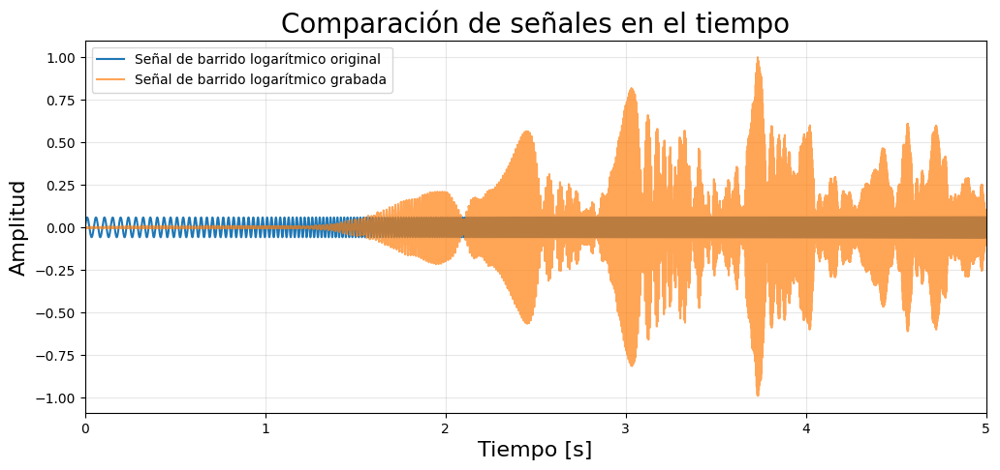

In [371]:
aux.plot_two_signals(x_expsweep,y_expsweep,fs, xlim=5,label1='Señal de barrido logarítmico original', label2='Señal de barrido logarítmico grabada', title='Comparación de señales en el tiempo')

#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

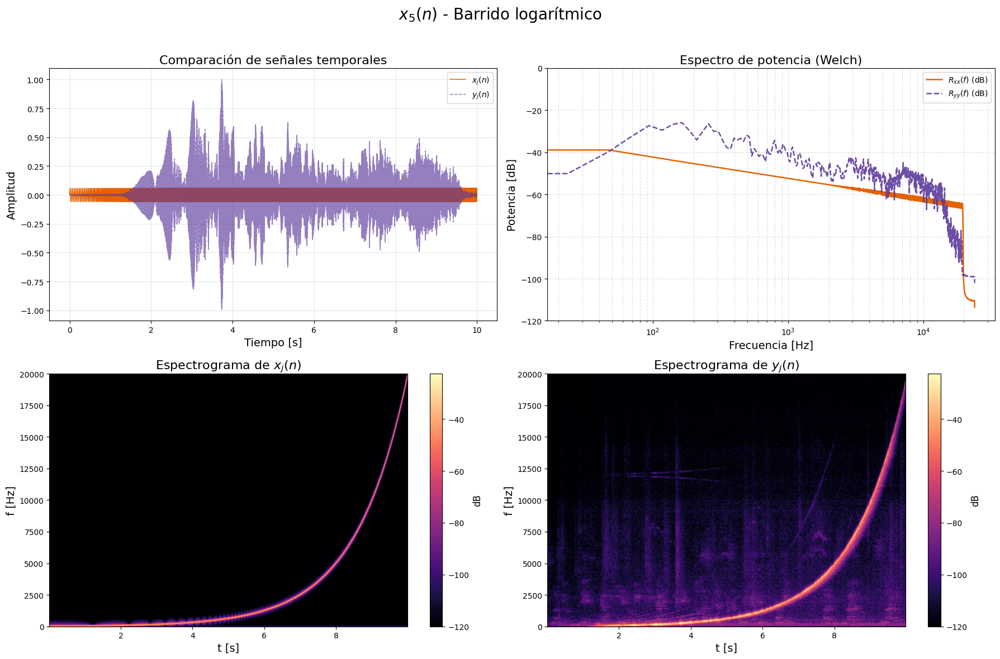

In [372]:
aux.get_graphs(x_expsweep, fs,y_expsweep, fs,'$x_5(n)$ - Barrido logarítmico')

## Conclusiones
**En la señal original (izquierda) el barrido logarítmico de 20 Hz a 20 kHz se presenta de forma clara y continua. El espectrograma muestra la típica curva logarítmica ascendente, con buena definición y sin ruidos adicionales que interfieran en la visualización. El espectro de potencia también mantiene un nivel estable en la mayor parte del rango de frecuencias, lo que refleja la precisión con la que fue generada la señal.**

**En la versión grabada (derecha), aunque la forma general del barrido logarítmico se conserva, aparecen limitaciones evidentes. El nivel general está atenuado y se observa una mayor cantidad de ruido de fondo, en especial en bajas frecuencias, lo que ensucia la definición de la curva en el espectrograma. Además, en el análisis de potencia se nota una pérdida progresiva en frecuencias medias y altas, lo que indica que el sistema de grabación (micrófono y entorno) introduce distorsiones y no logra reproducir el barrido con la misma fidelidad que la señal original.**

### 1.6 Ruido blanco gaussiano $x_6(n)$
#### N~(0,1)
#### Señal original

In [373]:
fs, x_awgn = read('../PASA-TP2/tracks/x_awgn.wav')
print(f'Sample rate: {fs}, Audio length: {x_awgn.shape[0]/fs} seconds')
ipd.Audio(x_awgn, rate=fs)

Sample rate: 48000, Audio length: 10.510208333333333 seconds


#### Señal grabada

In [374]:
fs, y_awgn = read('../PASA-TP2/tracks/y_awgn_cuarto.wav')
print(f'Sample rate: {fs}, Audio length: {y_awgn.shape[0]/fs} seconds')
ipd.Audio(y_awgn, rate=fs)

Sample rate: 48000, Audio length: 10.5271875 seconds


#### Graficamos la señal en el tiempo, su espectro de potencia y espectograma

Grafico las excitaciones $x_j(n)$ en el tiempo, su espectro de potencia y espectrograma y los comparo con sus equivalentes en la señal grabada $y_j(n)$.

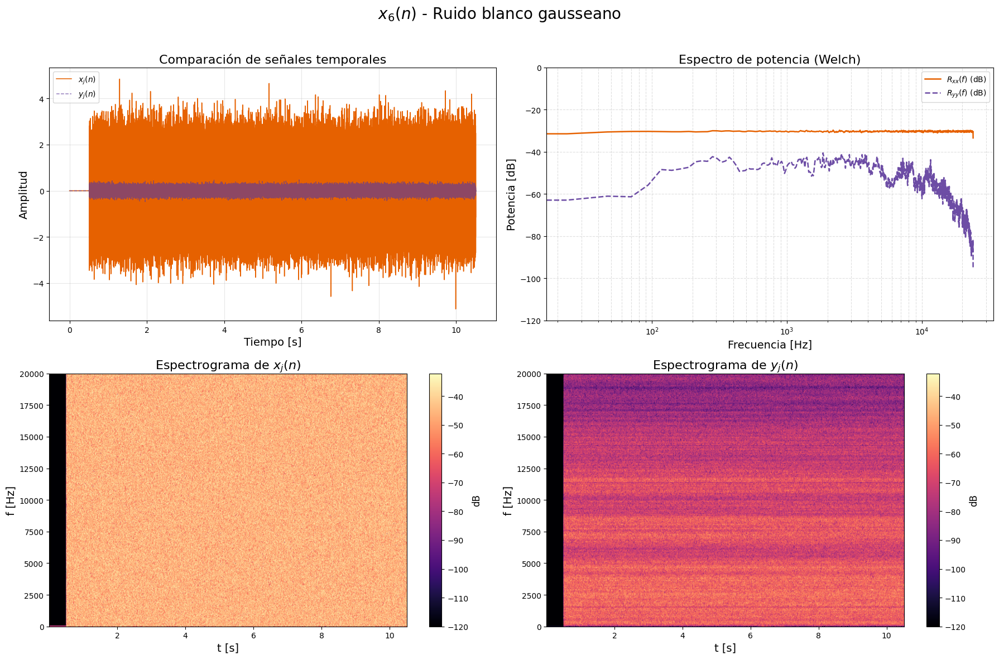

In [375]:
aux.get_graphs(x_awgn, fs,y_awgn, fs,'$x_6(n)$ - Ruido blanco gausseano')

# Cálculo del Filtro optimo

Notar que la señal tiene un parámetro LD que define si se utiliza el algoritmo de Levinson Durbin lo cual acelera dramaticamente la velocidad de los calculos

In [376]:
def CalculateOptimumFilter(input_signal, desired_response, order, p = None, rxx = None, LD = True):
    # Checks
    if (p is None) != (rxx is None):
        raise TypeError("p and R must be specified together")

    # Calculate the parameters if not provided
    if p is None and rxx is None:
        y = desired_response
        x = input_signal
        # Calculate the autocorrelation sequence p and crosscorrelation matrix using the toeplitz property
        rxx = sp.correlate(x, x,  method="fft") / len(x)
        p = sp.correlate(y, x , method="fft") / len(x)

        # Only keep the positive lag ends and adjust for order
        rxx = rxx[rxx.argmax():rxx.argmax()+order+1]
        p = p[len(p)//2:(len(p)//2)+order+1]

    if LD:
        rxx_c = np.conj(rxx)
        rxx_c[0] = rxx[0]
        wo = linalg.solve_toeplitz((rxx_c, rxx), p)
    else:
        R = linalg.toeplitz(rxx)
        wo = np.dot(linalg.inv(R), p)

    Jo = y.var() - p.dot(wo)

    return wo, Jo

## Find Delay
Esta funcion Encuentra el lag entre dos señales usando correlación cruzada

In [377]:
def find_delay(x, y):
    # Calcula la correlación cruzada
    correlation = sp.correlate(y, x, method='fft')
    
    # Encuentra el índice del máximo
    delay_idx = np.argmax(np.abs(correlation))
    
    # Calcula el delay real (considerando que correlation tiene 2*len-1 puntos)
    delay = delay_idx - (len(x) - 1)
    
    return delay

# Ejemplo de uso
delay = find_delay(x_linear_sweep, y_linear_sweep)
print(f"Delay detectado: {delay} muestras ({delay/fs:.3f} segundos)")

# Alinea las señales
if delay > 0:
    x_aligned = x_linear_sweep[:-delay] if delay < len(x_linear_sweep) else []
    y_aligned = y_linear_sweep[delay:]
else:
    x_aligned = x_linear_sweep[-delay:]
    y_aligned = y_linear_sweep[:delay] if delay < 0 else y_linear_sweep

delay = find_delay(x_aligned, y_aligned)
print(f"Delay final: {delay} muestras ({delay/fs:.3f} segundos)")


Delay detectado: 1895 muestras (0.039 segundos)
Delay final: 0 muestras (0.000 segundos)


## Run Analysis
Esta funcion corre una suite de calculos para graficar los resultados al aplicar filtrado lineal optimo a un par de entrada y salida deseada

In [378]:
def RunAnalysis(input, desired_response, max_order, num_points):
    x = input
    y = desired_response
    print("tamaño x: ", x.shape)
    print("tamaño y: ", y.shape)
    
    max_M = max_order
    num_runs = num_points
    log_div = np.log10(max_M)/num_runs
    Ms = []
    for i in range(num_runs+1):
        Ms.append(int(10 ** (log_div*i)))
    print(Ms)
    num_runs = len(Ms)
    results = np.zeros(num_runs)
    final_w = []
    
    for i in range(num_runs):
        wo, Jo = CalculateOptimumFilter(x[:len(y)], y, Ms[i])
        results[i] = Jo / np.var(y)
        final_w.append(wo)
    
    t = np.linspace(0, 1/fs * len(y), len(y))
    fig, axs = plt.subplots(1, 2, figsize=(18, 5))
    
    axs[0].plot(Ms, results)
    axs[0].set_xlabel("Filter Order")
    axs[0].set_ylabel("MSE")
    axs[0].set_title("MSE vs Filter Order")
    axs[0].grid()
    
    axs[1].set_title("Final Coefficients")
    axs[1].set_xlabel("Wo Coefficients")
    axs[1].stem(final_w[results.argmin()], label="W coefficients")
    axs[1].legend()
    axs[1].grid()
    
    plt.tight_layout()
    plt.show()
    print("Minimum MSE: ", results.min(), " at M = ", Ms[results.argmin()])
    
    # H(w)
    H = np.fft.fft(final_w[results.argmin()])

    return final_w[results.argmin()], H
    

A continuación se realizará una prueba para corroborar el correcto funcionamiento del diseño. Se crea un filtro de prueba con coeficientes seleccionados aleatoriamente entre 1 y 1/order. La señal de entrada es ruido gaussiano y la señal deseada es la salida del filtro mas un componente de ruido gaussiano adicional. Luego se calcula el filtro optimo para distintos ordenes del filtro y se observa el MSE obtenido para cada orden. Lo esperado es que el MSE sea monótonamente decreciente hasta que el orden del filtro optimo sea equivalente al del filtro real. Una vez alcanzado este punto, los coeficientes del filtro optimo Wn deberían estimar aquellos del filtro real hn.

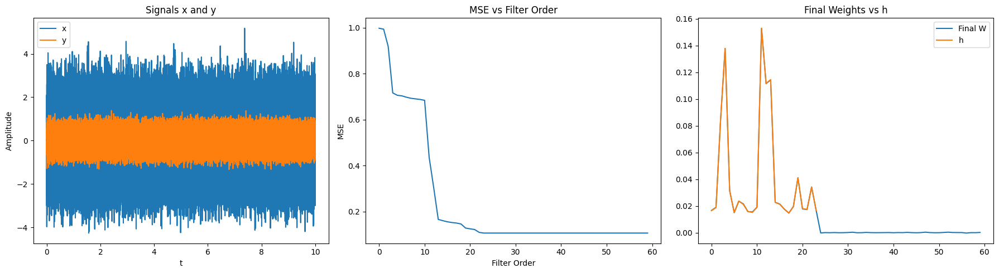

Minimum MSE:  0.10618936187305537  at M =  59


In [379]:
time = 10
fs = 48000

t = np.linspace(0, time, int(time * fs))
x = np.random.normal(0, 1, len(t))

# Dummy filter
order = 24
h = np.ones(order) / np.random.uniform(1, order, order)
h = h / np.sum(h)
y = sp.lfilter(h, 1, x) + np.random.normal(0, 0.1, len(t))

num_runs = 60
results = np.zeros(num_runs)
final_w = []
for i in range(num_runs):
    wo, Jo = CalculateOptimumFilter(x, y, i)
    results[i] = Jo / np.var(y)
    if i == num_runs - 1:
        final_w = wo

fig, axs = plt.subplots(1, 3, figsize=(18, 5))

axs[0].plot(t, x, label="x")
axs[0].plot(t, y, label="y")
axs[0].set_xlabel("t")
axs[0].set_ylabel("Amplitude")
axs[0].legend()
axs[0].set_title("Signals x and y")

axs[1].plot(results)
axs[1].set_xlabel("Filter Order")
axs[1].set_ylabel("MSE")
axs[1].set_title("MSE vs Filter Order")

axs[2].plot(final_w, label="Final W")
axs[2].plot(h, label="h")
axs[2].set_title("Final Weights vs h")
axs[2].legend()

plt.tight_layout()
plt.show()

print("Minimum MSE: ", results.min(), " at M = ", results.argmin())

Luego se tomaran realizarán los calculos para los distintos pares de señales

39668
668
tamaño x:  (462361,)
tamaño y:  (462361,)
[1, 1, 1, 2, 2, 3, 4, 6, 7, 10, 13, 17, 22, 28, 36, 47, 61, 79, 103, 133, 173, 224, 290, 375, 485, 628, 813, 1052, 1361, 1761, 2279, 2949, 3816, 4938, 6390, 8269, 10700, 13846, 17916, 23184, 30000]


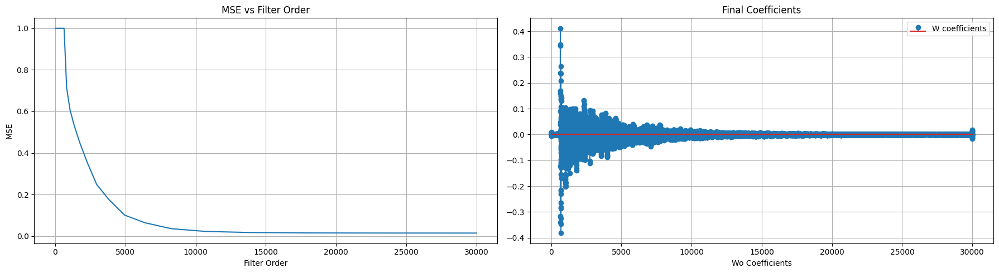

Minimum MSE:  0.014486507387180178  at M =  30000


In [399]:
y = y_linear_sweep
x = x_linear_sweep[:len(y)]

delay = (find_delay(x, y))
print(delay)
y = y[39000:-5000]
x = x[:len(y)]

delay = (find_delay(x, y))
print(delay)

lin_wo, H_lin = RunAnalysis(x, y, 30000, 40)

Como se puede observar en el grafico, los valores de Wo superiores a 15000 se encuentran bajo un piso de ruido, lo cual indica que un M de 15000 puede llegar a ser una buena estimación.

# Exponential Sweep

1168
2185
tamaño x:  (478453,)
tamaño y:  (478453,)
[1, 1, 1, 2, 2, 3, 4, 6, 7, 10, 13, 17, 22, 28, 36, 47, 61, 79, 103, 133, 173, 224, 290, 375, 485, 628, 813, 1052, 1361, 1761, 2279, 2949, 3816, 4938, 6390, 8269, 10700, 13846, 17916, 23184, 30000]


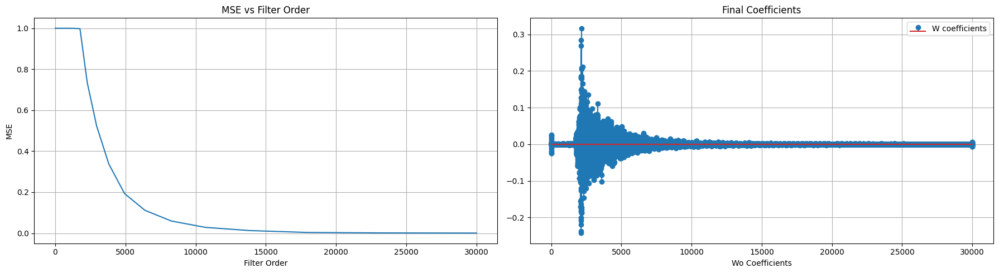

Minimum MSE:  0.0005504867680072166  at M =  30000


In [381]:
y = y_expsweep
x = x_expsweep[:len(y_expsweep)]

delay = (find_delay(x, y))
print(delay)
x = x[np.abs((delay-151)):]
y = y[:len(x)]

delay = (find_delay(x, y))
print(delay)

w_expo, H_exp = RunAnalysis(x, y, 30000, 40)

Como se puede observar, el MSE normalizado es mucho menor a aquel obtenido con el barrido lineal. Además, en el gráfico de Wo se puede observar claramente como valores superiores a los 15000 coeficientes estan dentro del piso de ruido, por lo que un buen estimador de M podria ser 15000.

# Speech Signal

tamaño x:  (457861,)
tamaño y:  (457861,)
[1, 1, 1, 2, 2, 3, 4, 5, 6, 8, 11, 14, 17, 22, 28, 36, 46, 59, 75, 96, 122, 155, 198, 251, 320, 407, 518, 658, 838, 1065, 1355, 1723, 2192, 2787, 3545, 4508, 5734, 7292, 9274, 11794, 15000]


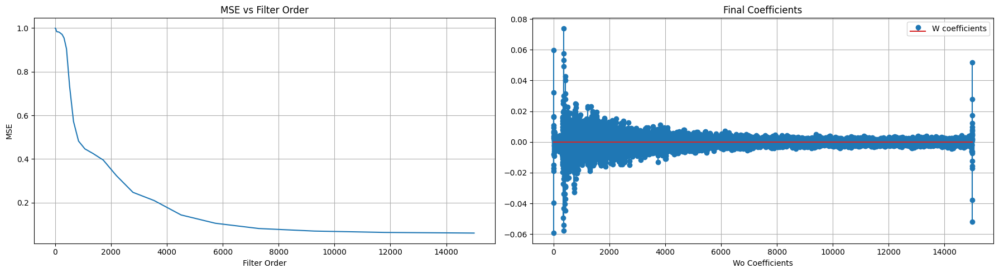

Minimum MSE:  0.061021305514623744  at M =  15000


(array([ 0.03199529, -0.05933228,  0.0597424 , ...,  0.05192705,
        -0.05208085,  0.02776043], shape=(15001,)),
 array([-0.21240872-1.24900090e-16j, -0.02532487-1.11755340e-01j,
        -0.03662299-1.38115701e-01j, ..., -0.00146232+9.04618224e-02j,
        -0.03662299+1.38115701e-01j, -0.02532487+1.11755340e-01j],
       shape=(15001,)))

In [382]:
y = y_speech[15000:-15000]
x = x_speech[:len(y)]

delay = (find_delay(x, y))
x = x[np.abs((delay-551)):]
y = y[:len(x)]

delay = (find_delay(x, y))

RunAnalysis(x, y, 15000, 40)

# Music

tamaño x:  (460998,)
tamaño y:  (460998,)
[1, 1, 1, 2, 2, 3, 4, 5, 6, 8, 11, 14, 17, 22, 28, 36, 46, 59, 75, 96, 122, 155, 198, 251, 320, 407, 518, 658, 838, 1065, 1355, 1723, 2192, 2787, 3545, 4508, 5734, 7292, 9274, 11794, 15000]


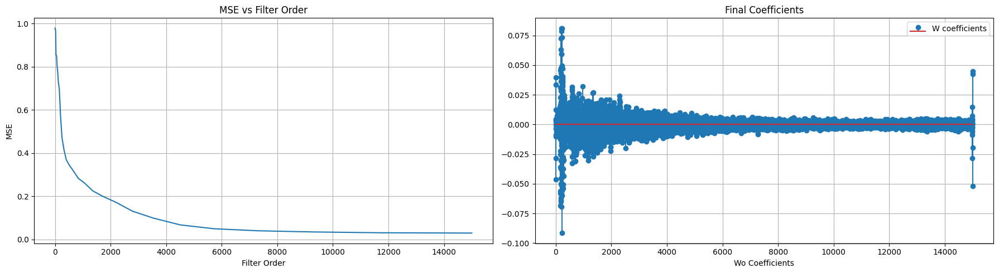

Minimum MSE:  0.029069220922255487  at M =  15000


(array([-0.01022016,  0.03375383, -0.04647906, ..., -0.05179202,
         0.04243162, -0.01931693], shape=(15001,)),
 array([0.03772049-1.00613962e-16j, 0.19526448-2.65687720e-02j,
        0.11726775-6.67469502e-02j, ..., 0.11302188-2.64370795e-02j,
        0.11726775+6.67469502e-02j, 0.19526448+2.65687720e-02j],
       shape=(15001,)))

In [383]:
y = y_music_1[15000:-15000]
x = x_music_1[:len(y)]

delay = (find_delay(x, y))
x = x[np.abs((delay-551)):]
y = y[:len(x)]

delay = (find_delay(x, y))

RunAnalysis(x, y, 15000, 40)

# Square Signal

324
551
tamaño x:  (479773,)
tamaño y:  (479773,)
[1, 1, 1, 2, 2, 3, 4, 5, 6, 8, 11, 14, 17, 22, 28, 36, 46, 59, 75, 96, 122, 155, 198, 251, 320, 407, 518, 658, 838, 1065, 1355, 1723, 2192, 2787, 3545, 4508, 5734, 7292, 9274, 11794, 15000]


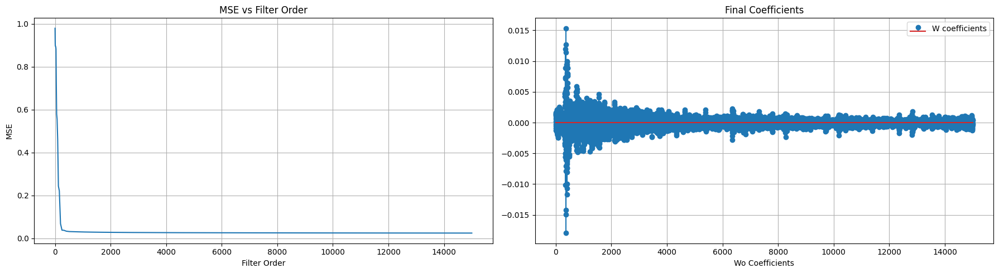

Minimum MSE:  0.02405921803736346  at M =  15000


(array([-0.00130125, -0.00089746, -0.00056916, ...,  0.00036666,
        -0.00021601, -0.00035977], shape=(15001,)),
 array([0.00856079-5.46437895e-17j, 0.00781527-2.97479340e-04j,
        0.00491463+2.25080069e-03j, ..., 0.01225864+2.29522141e-03j,
        0.00491463-2.25080069e-03j, 0.00781527+2.97479340e-04j],
       shape=(15001,)))

In [384]:
y = y_square
x = x_square[:len(y)]

delay = (find_delay(x, y))
print(delay)
x = x[np.abs((delay-551)):]
y = y[:len(x)]

delay = (find_delay(x, y))
print(delay)

RunAnalysis(x, y, 15000, 40)

## White noise

-15901
551
tamaño x:  (458853,)
tamaño y:  (458853,)
[1, 1, 1, 2, 2, 3, 4, 5, 7, 9, 11, 15, 19, 24, 32, 41, 52, 67, 86, 110, 141, 181, 232, 297, 380, 487, 624, 800, 1024, 1312, 1681, 2154, 2759, 3534, 4527, 5799, 7428, 9515, 12189, 15613, 20000]


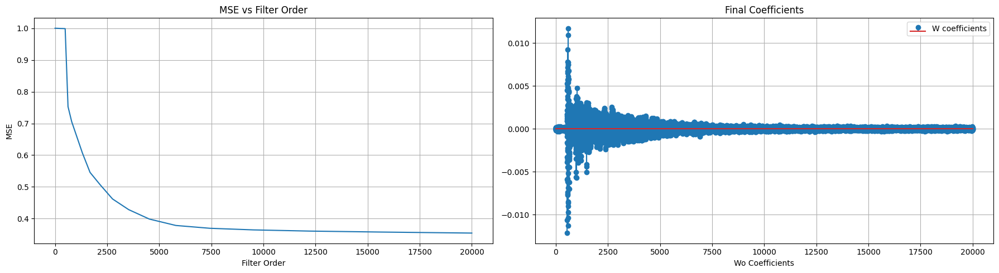

Minimum MSE:  0.35433880772778037  at M =  20000


(array([-4.47875871e-06,  7.09951595e-05, -4.94181009e-05, ...,
         9.49255605e-05,  1.10997551e-04, -2.92136045e-05], shape=(20001,)),
 array([ 0.0006413 +0.j        , -0.0004993 +0.00016157j,
        -0.0008018 +0.00045347j, ..., -0.00028415-0.00031604j,
        -0.0008018 -0.00045347j, -0.0004993 -0.00016157j], shape=(20001,)))

In [385]:
y = y_awgn[15000:-15000]
x = x_awgn[:len(y)]

delay = (find_delay(x, y))
print(delay)
x = x[np.abs((delay-551)):]
y = y[:len(x)]

delay = (find_delay(x, y))
print(delay)

RunAnalysis(x, y, 20000, 40)

## Puesta a prueba del filtro
En la teoría, el filtro obtenido por el analisis del barrido lineal debería ser aquel que mejor se asemeje a la respuesta de la habitación, dado a que presenta la distribución de energia mas plana y por ende equitativa entre todas las frecuencias. Sin embargo, dado que la sensibilidad del oido humano es de caracter exponencial, las variaciónes en las frecuencias mas bajas del espectro del filtro son considerablemente mas notorias que aquellas que ocurran las frecuencias superiores. Ésta es la principal razon por la cual el barrido exponencial es la pista de audio que produce el filtro que mas se aparenta, al menos para el oido humano, a la respuesta real de la habitación. Esto se debe a que la gran mayoría de la potencia se concentra en bajas frecuencias donde el oido es mas sensible por lo previamente mencionado.


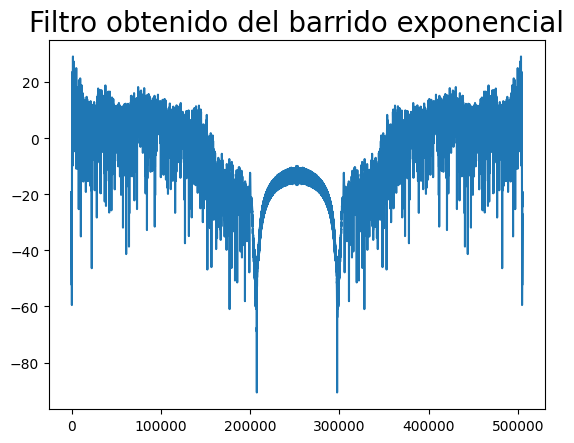

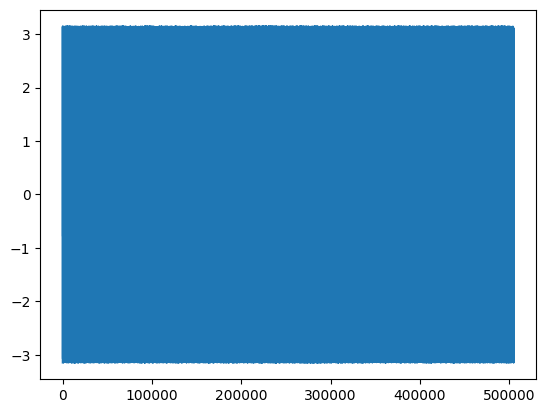

In [386]:
h = np.zeros(len(x_music_2))
start = len(h)//2 - len(w_expo)//2
h[start:start+len(w_expo)] = w_expo

H = np.fft.fft(h)
plt.figure()
plt.plot(20*np.log10(np.abs(H)), label="H(w)")
plt.title('Filtro obtenido del barrido exponencial', fontsize=20)
plt.figure()
plt.plot(np.angle(H), label="Phase of H(w)")

X_music2 = np.fft.fft(x_music_2)
Result = X_music2 * H
y_music2_filtered = np.fft.fftshift(np.fft.ifft(Result)).real

ipd.Audio(y_music2_filtered, rate=fs)

Comparación con filtro del barrido lineal.

Habiendo mencionado lo anterior, el resultado con el filtro del barrido lineal parecería sonar mas similar a la grabación.

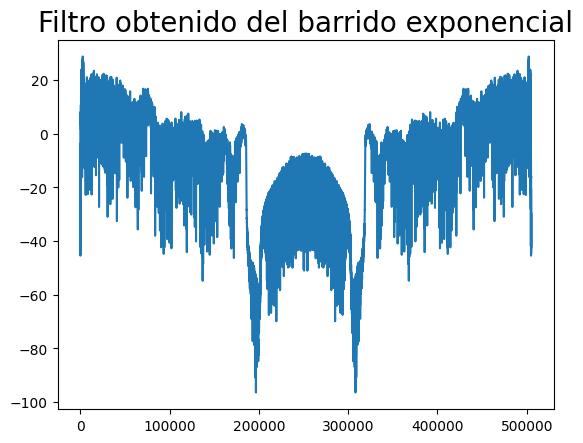

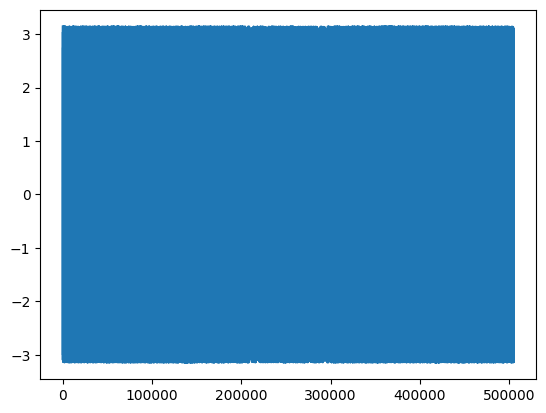

In [400]:

h = np.zeros(len(x_music_2))
start = len(h)//2 - len(lin_wo)//2
h[start:start+len(lin_wo)] = lin_wo

H = np.fft.fft(h)
plt.figure()
plt.plot(20*np.log10(np.abs(H)), label="H(w)")
plt.title('Filtro obtenido del barrido exponencial', fontsize=20)
plt.figure()
plt.plot(np.angle(H), label="Phase of H(w)")

Result = X_music2 * H
y_music2_filtered = np.fft.fftshift(np.fft.ifft(Result)).real

ipd.Audio(y_music2_filtered, rate=fs)